In [11]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import sklearn
from scipy import ndimage, misc
import math
%matplotlib inline
import cv2
import time
import glob


In [14]:
def FindContour_and_outer_defect(gray, contours_final,debug):
    
    hull = cv2.convexHull(contours_final[0])
    #=====
    convex_img = np.ones_like(gray)
    cv2.drawContours(convex_img, [hull],-1,(0,0,0),-1)
    convex_img = np.invert(convex_img)
    #=====
    contour_img = np.ones_like(gray)
    cv2.drawContours(contour_img, [contours_final[0]],-1,(0,0,0),-1)
    #print(contours_final[0].shape)
    mask = 1-contour_img
    contour_img = np.invert(contour_img)
    #=====
    diff_img = convex_img - contour_img
    #=====
    #kernel = np.ones((3,3),np.uint8)
    kernel = np.ones((3,2),np.uint8)
    opening = cv2.morphologyEx(diff_img, cv2.MORPH_OPEN, kernel)
    #=====
    nlabels, labels, stats, centroids = cv2.connectedComponentsWithStats(opening)
    
    if(debug):
        plt.figure(figsize=(20,20))
        plt.imshow(contour_img,cmap = 'gray')    
    
    return stats, mask

def create_circular_mask(h, w, center=None, radius=None):

    if center is None: # use the middle of the image
        center = (int(w/2), int(h/2))
    if radius is None: # use the smallest distance between the center and image walls
        radius = min(center[0], center[1], w-center[0], h-center[1])

    Y, X = np.ogrid[:h, :w]
    dist_from_center = np.sqrt((X - center[0])**2 + (Y-center[1])**2)

    mask = dist_from_center < (radius+15)
    return mask

def mask_innercicle(img,debug):
    
    ret, thresh1 = cv2.threshold(img, 230, 255, cv2.THRESH_BINARY)
    _ , contours, hierarchy = cv2.findContours(thresh1,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
    
    
    #backtorgb = cv2.cvtColor(img,cv2.COLOR_GRAY2RGB)   
    import circle_fit as cf
    contours_final = []
    for i in range(np.array(contours).shape[0]):
            
            if(cv2.contourArea(contours[i])>1000000 and cv2.contourArea(contours[i])<2500000):
                #print(cv2.contourArea(contours[i]))
                contours_final.append(contours[i])
                #cv2.drawContours(backtorgb, contours, i, (255, 0, 0), 4);
                
    #if(debug):
#        plt.figure(figsize=(20,20))
#        plt.imshow(backtorgb,cmap = 'gray')        
    
    #===================circle fit for inner cycle=============================
    cor = np.array(contours_final[1])
    cor = cor.reshape(cor.shape[0],cor.shape[2])

    xc,yc,r,_ = cf.least_squares_circle(cor)

    h = img.shape[0]
    w = img.shape[1]
    center = (xc.astype(int), yc.astype(int))
    radius = r.astype(int)
    mask = create_circular_mask(h, w, center=center, radius=radius)
    
    mask_array = np.ma.masked_array(img, mask=mask,fill_value = 255)
    #plt.figure(figsize=(20,20))
    #plt.imshow(mask,cmap = 'gray')       
    
    img_temp = mask_array.filled()
    
    return img_temp, contours_final

0518ALL_Data/CCD-2\1.jpg
3.090768337249756
.\Detect\Stop2\1_Detect.jpg
0518ALL_Data/CCD-2\10.jpg
2.942162275314331
.\Detect\Stop2\10_Detect.jpg
0518ALL_Data/CCD-2\100.jpg
0.9574460983276367
.\Detect\Stop2\100_Detect.jpg
0518ALL_Data/CCD-2\1000.jpg
0.8636934757232666
.\Detect\Stop2\1000_Detect.jpg
0518ALL_Data/CCD-2\1001.jpg
1.6565675735473633
.\Detect\Stop2\1001_Detect.jpg
0518ALL_Data/CCD-2\1002.jpg
3.0617916584014893
.\Detect\Stop2\1002_Detect.jpg
0518ALL_Data/CCD-2\1003.jpg
0.7808830738067627
.\Detect\Stop2\1003_Detect.jpg
0518ALL_Data/CCD-2\1004.jpg
0.8178446292877197
.\Detect\Stop2\1004_Detect.jpg
0518ALL_Data/CCD-2\1005.jpg
3.834742784500122
.\Detect\Stop2\1005_Detect.jpg
0518ALL_Data/CCD-2\1006.jpg
1.430145025253296
.\Detect\Stop2\1006_Detect.jpg
0518ALL_Data/CCD-2\1007.jpg
1.1618647575378418
.\Detect\Stop2\1007_Detect.jpg
0518ALL_Data/CCD-2\1008.jpg
2.7346842288970947
.\Detect\Stop2\1008_Detect.jpg
0518ALL_Data/CCD-2\1009.jpg
1.1788196563720703
.\Detect\Stop2\1009_Detect.jpg
05

C:\Users\Chernger\Anaconda3\envs\tensorflow-gpu\lib\site-packages\ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


0.7190840244293213
.\Detect\Stop2\106_Detect.jpg
0518ALL_Data/CCD-2\107.jpg
0.7599444389343262
.\Detect\Stop2\107_Detect.jpg
0518ALL_Data/CCD-2\108.jpg
3.653226375579834
.\Detect\Stop2\108_Detect.jpg
0518ALL_Data/CCD-2\109.jpg
2.040513038635254
.\Detect\Stop2\109_Detect.jpg
0518ALL_Data/CCD-2\11.jpg
6.084753751754761
.\Detect\Stop2\11_Detect.jpg
0518ALL_Data/CCD-2\110.jpg
2.8383803367614746
.\Detect\Stop2\110_Detect.jpg
0518ALL_Data/CCD-2\111.jpg
1.6874847412109375
.\Detect\Stop2\111_Detect.jpg
0518ALL_Data/CCD-2\112.jpg
2.8702902793884277
.\Detect\Stop2\112_Detect.jpg
0518ALL_Data/CCD-2\113.jpg
0.924525260925293
.\Detect\Stop2\113_Detect.jpg
0518ALL_Data/CCD-2\114.jpg
1.1439414024353027
.\Detect\Stop2\114_Detect.jpg
0518ALL_Data/CCD-2\115.jpg
1.5957283973693848
.\Detect\Stop2\115_Detect.jpg
0518ALL_Data/CCD-2\116.jpg
1.1279823780059814
.\Detect\Stop2\116_Detect.jpg
0518ALL_Data/CCD-2\117.jpg
2.881279468536377
.\Detect\Stop2\117_Detect.jpg
0518ALL_Data/CCD-2\118.jpg
1.1997599601745605


0.8945789337158203
.\Detect\Stop2\204_Detect.jpg
0518ALL_Data/CCD-2\205.jpg
1.5129551887512207
.\Detect\Stop2\205_Detect.jpg
0518ALL_Data/CCD-2\206.jpg
0.7220993041992188
.\Detect\Stop2\206_Detect.jpg
0518ALL_Data/CCD-2\207.jpg
0.7211019992828369
.\Detect\Stop2\207_Detect.jpg
0518ALL_Data/CCD-2\208.jpg
2.328742027282715
.\Detect\Stop2\208_Detect.jpg
0518ALL_Data/CCD-2\209.jpg
0.7091319561004639
.\Detect\Stop2\209_Detect.jpg
0518ALL_Data/CCD-2\21.jpg
0.9225058555603027
.\Detect\Stop2\21_Detect.jpg
0518ALL_Data/CCD-2\210.jpg
1.72090482711792
.\Detect\Stop2\210_Detect.jpg
0518ALL_Data/CCD-2\211.jpg
3.8816044330596924
.\Detect\Stop2\211_Detect.jpg
0518ALL_Data/CCD-2\212.jpg
3.973400592803955
.\Detect\Stop2\212_Detect.jpg
0518ALL_Data/CCD-2\213.jpg
5.147261142730713
.\Detect\Stop2\213_Detect.jpg
0518ALL_Data/CCD-2\214.jpg
2.18914532661438
.\Detect\Stop2\214_Detect.jpg
0518ALL_Data/CCD-2\215.jpg
4.3114728927612305
.\Detect\Stop2\215_Detect.jpg
0518ALL_Data/CCD-2\216.jpg
1.2466418743133545
.\

1.0950634479522705
.\Detect\Stop2\302_Detect.jpg
0518ALL_Data/CCD-2\303.jpg
0.7699682712554932
.\Detect\Stop2\303_Detect.jpg
0518ALL_Data/CCD-2\304.jpg
0.7370278835296631
.\Detect\Stop2\304_Detect.jpg
0518ALL_Data/CCD-2\305.jpg
0.9225060939788818
.\Detect\Stop2\305_Detect.jpg
0518ALL_Data/CCD-2\306.jpg
1.1060426235198975
.\Detect\Stop2\306_Detect.jpg
0518ALL_Data/CCD-2\307.jpg
2.6319327354431152
.\Detect\Stop2\307_Detect.jpg
0518ALL_Data/CCD-2\308.jpg
1.9557688236236572
.\Detect\Stop2\308_Detect.jpg
0518ALL_Data/CCD-2\309.jpg
1.074141263961792
.\Detect\Stop2\309_Detect.jpg
0518ALL_Data/CCD-2\31.jpg
3.282254219055176
.\Detect\Stop2\31_Detect.jpg
0518ALL_Data/CCD-2\310.jpg
3.282191514968872
.\Detect\Stop2\310_Detect.jpg
0518ALL_Data/CCD-2\311.jpg
1.0472285747528076
.\Detect\Stop2\311_Detect.jpg
0518ALL_Data/CCD-2\312.jpg
1.0332741737365723
.\Detect\Stop2\312_Detect.jpg
0518ALL_Data/CCD-2\313.jpg
0.723092794418335
.\Detect\Stop2\313_Detect.jpg
0518ALL_Data/CCD-2\314.jpg
4.1752448081970215

1.991645097732544
.\Detect\Stop2\400_Detect.jpg
0518ALL_Data/CCD-2\401.jpg
1.4601001739501953
.\Detect\Stop2\401_Detect.jpg
0518ALL_Data/CCD-2\402.jpg
0.9304792881011963
.\Detect\Stop2\402_Detect.jpg
0518ALL_Data/CCD-2\403.jpg
0.9195141792297363
.\Detect\Stop2\403_Detect.jpg
0518ALL_Data/CCD-2\404.jpg
1.0860662460327148
.\Detect\Stop2\404_Detect.jpg
0518ALL_Data/CCD-2\405.jpg
2.661879301071167
.\Detect\Stop2\405_Detect.jpg
0518ALL_Data/CCD-2\406.jpg
1.7752857208251953
.\Detect\Stop2\406_Detect.jpg
0518ALL_Data/CCD-2\407.jpg
0.7689576148986816
.\Detect\Stop2\407_Detect.jpg
0518ALL_Data/CCD-2\408.jpg
1.121976613998413
.\Detect\Stop2\408_Detect.jpg
0518ALL_Data/CCD-2\409.jpg
0.7789449691772461
.\Detect\Stop2\409_Detect.jpg
0518ALL_Data/CCD-2\41.jpg
0.7758965492248535
.\Detect\Stop2\41_Detect.jpg
0518ALL_Data/CCD-2\410.jpg
0.9205710887908936
.\Detect\Stop2\410_Detect.jpg
0518ALL_Data/CCD-2\411.jpg
4.525895595550537
.\Detect\Stop2\411_Detect.jpg
0518ALL_Data/CCD-2\412.jpg
0.7729284763336182

0.7101008892059326
.\Detect\Stop2\5_Detect.jpg
0518ALL_Data/CCD-2\50.jpg
1.9917068481445312
.\Detect\Stop2\50_Detect.jpg
0518ALL_Data/CCD-2\500.jpg
1.4989631175994873
.\Detect\Stop2\500_Detect.jpg
0518ALL_Data/CCD-2\501.jpg
0.7290499210357666
.\Detect\Stop2\501_Detect.jpg
0518ALL_Data/CCD-2\502.jpg
2.286856174468994
.\Detect\Stop2\502_Detect.jpg
0518ALL_Data/CCD-2\503.jpg
1.524954080581665
.\Detect\Stop2\503_Detect.jpg
0518ALL_Data/CCD-2\504.jpg
0.7160556316375732
.\Detect\Stop2\504_Detect.jpg
0518ALL_Data/CCD-2\505.jpg
1.2037837505340576
.\Detect\Stop2\505_Detect.jpg
0518ALL_Data/CCD-2\506.jpg
1.5069401264190674
.\Detect\Stop2\506_Detect.jpg
0518ALL_Data/CCD-2\507.jpg
1.3424484729766846
.\Detect\Stop2\507_Detect.jpg
0518ALL_Data/CCD-2\508.jpg
1.042184829711914
.\Detect\Stop2\508_Detect.jpg
0518ALL_Data/CCD-2\509.jpg
2.294895648956299
.\Detect\Stop2\509_Detect.jpg
0518ALL_Data/CCD-2\51.jpg
2.302835702896118
.\Detect\Stop2\51_Detect.jpg
0518ALL_Data/CCD-2\510.jpg
1.5259170532226562
.\De

0.7151226997375488
.\Detect\Stop2\598_Detect.jpg
0518ALL_Data/CCD-2\599.jpg
2.2968266010284424
.\Detect\Stop2\599_Detect.jpg
0518ALL_Data/CCD-2\6.jpg
2.357693672180176
.\Detect\Stop2\6_Detect.jpg
0518ALL_Data/CCD-2\60.jpg
1.5199005603790283
.\Detect\Stop2\60_Detect.jpg
0518ALL_Data/CCD-2\600.jpg
1.3443751335144043
.\Detect\Stop2\600_Detect.jpg
0518ALL_Data/CCD-2\601.jpg
0.8717072010040283
.\Detect\Stop2\601_Detect.jpg
0518ALL_Data/CCD-2\602.jpg
0.7310516834259033
.\Detect\Stop2\602_Detect.jpg
0518ALL_Data/CCD-2\603.jpg
0.7021212577819824
.\Detect\Stop2\603_Detect.jpg
0518ALL_Data/CCD-2\604.jpg
1.0422179698944092
.\Detect\Stop2\604_Detect.jpg
0518ALL_Data/CCD-2\605.jpg
0.6971354484558105
.\Detect\Stop2\605_Detect.jpg
0518ALL_Data/CCD-2\606.jpg
2.072460412979126
.\Detect\Stop2\606_Detect.jpg
0518ALL_Data/CCD-2\607.jpg
1.2127561569213867
.\Detect\Stop2\607_Detect.jpg
0518ALL_Data/CCD-2\608.jpg
1.1020526885986328
.\Detect\Stop2\608_Detect.jpg
0518ALL_Data/CCD-2\609.jpg
1.8350615501403809
.

4.0052900314331055
.\Detect\Stop2\696_Detect.jpg
0518ALL_Data/CCD-2\697.jpg
4.650586843490601
.\Detect\Stop2\697_Detect.jpg
0518ALL_Data/CCD-2\698.jpg
2.0176358222961426
.\Detect\Stop2\698_Detect.jpg
0518ALL_Data/CCD-2\699.jpg
1.1967980861663818
.\Detect\Stop2\699_Detect.jpg
0518ALL_Data/CCD-2\7.jpg
0.9065494537353516
.\Detect\Stop2\7_Detect.jpg
0518ALL_Data/CCD-2\70.jpg
2.932192087173462
.\Detect\Stop2\70_Detect.jpg
0518ALL_Data/CCD-2\700.jpg
1.6535491943359375
.\Detect\Stop2\700_Detect.jpg
0518ALL_Data/CCD-2\701.jpg
0.717111349105835
.\Detect\Stop2\701_Detect.jpg
0518ALL_Data/CCD-2\702.jpg
2.457397699356079
.\Detect\Stop2\702_Detect.jpg
0518ALL_Data/CCD-2\703.jpg
1.188833475112915
.\Detect\Stop2\703_Detect.jpg
0518ALL_Data/CCD-2\704.jpg
0.7370278835296631
.\Detect\Stop2\704_Detect.jpg
0518ALL_Data/CCD-2\705.jpg
1.5248839855194092
.\Detect\Stop2\705_Detect.jpg
0518ALL_Data/CCD-2\706.jpg
1.3523454666137695
.\Detect\Stop2\706_Detect.jpg
0518ALL_Data/CCD-2\707.jpg
0.7140936851501465
.\De

1.0302128791809082
.\Detect\Stop2\794_Detect.jpg
0518ALL_Data/CCD-2\795.jpg
1.6396167278289795
.\Detect\Stop2\795_Detect.jpg
0518ALL_Data/CCD-2\796.jpg
3.0548081398010254
.\Detect\Stop2\796_Detect.jpg
0518ALL_Data/CCD-2\797.jpg
0.7210705280303955
.\Detect\Stop2\797_Detect.jpg
0518ALL_Data/CCD-2\798.jpg
0.7101008892059326
.\Detect\Stop2\798_Detect.jpg
0518ALL_Data/CCD-2\799.jpg
0.716057300567627
.\Detect\Stop2\799_Detect.jpg
0518ALL_Data/CCD-2\8.jpg
1.1838014125823975
.\Detect\Stop2\8_Detect.jpg
0518ALL_Data/CCD-2\80.jpg
3.3829240798950195
.\Detect\Stop2\80_Detect.jpg
0518ALL_Data/CCD-2\800.jpg
2.6189961433410645
.\Detect\Stop2\800_Detect.jpg
0518ALL_Data/CCD-2\801.jpg
0.8717024326324463
.\Detect\Stop2\801_Detect.jpg
0518ALL_Data/CCD-2\802.jpg
0.7490236759185791
.\Detect\Stop2\802_Detect.jpg
0518ALL_Data/CCD-2\803.jpg
4.228655815124512
.\Detect\Stop2\803_Detect.jpg
0518ALL_Data/CCD-2\804.jpg
6.254262685775757
.\Detect\Stop2\804_Detect.jpg
0518ALL_Data/CCD-2\805.jpg
0.8766660690307617
.\

2.12933611869812
.\Detect\Stop2\892_Detect.jpg
0518ALL_Data/CCD-2\893.jpg
1.8460617065429688
.\Detect\Stop2\893_Detect.jpg
0518ALL_Data/CCD-2\894.jpg
0.723038911819458
.\Detect\Stop2\894_Detect.jpg
0518ALL_Data/CCD-2\895.jpg
0.8886246681213379
.\Detect\Stop2\895_Detect.jpg
0518ALL_Data/CCD-2\896.jpg
1.187819480895996
.\Detect\Stop2\896_Detect.jpg
0518ALL_Data/CCD-2\897.jpg
0.7190818786621094
.\Detect\Stop2\897_Detect.jpg
0518ALL_Data/CCD-2\898.jpg
1.8141822814941406
.\Detect\Stop2\898_Detect.jpg
0518ALL_Data/CCD-2\899.jpg
0.8946080207824707
.\Detect\Stop2\899_Detect.jpg
0518ALL_Data/CCD-2\9.jpg
1.0312378406524658
.\Detect\Stop2\9_Detect.jpg
0518ALL_Data/CCD-2\90.jpg
1.2047715187072754
.\Detect\Stop2\90_Detect.jpg
0518ALL_Data/CCD-2\900.jpg
0.8995952606201172
.\Detect\Stop2\900_Detect.jpg
0518ALL_Data/CCD-2\901.jpg
2.0006139278411865
.\Detect\Stop2\901_Detect.jpg
0518ALL_Data/CCD-2\902.jpg
0.7141191959381104
.\Detect\Stop2\902_Detect.jpg
0518ALL_Data/CCD-2\903.jpg
0.7340362071990967
.\D

1.040221929550171
.\Detect\Stop2\990_Detect.jpg
0518ALL_Data/CCD-2\991.jpg
0.8716692924499512
.\Detect\Stop2\991_Detect.jpg
0518ALL_Data/CCD-2\992.jpg
0.7250592708587646
.\Detect\Stop2\992_Detect.jpg
0518ALL_Data/CCD-2\993.jpg
1.6815106868743896
.\Detect\Stop2\993_Detect.jpg
0518ALL_Data/CCD-2\994.jpg
0.8995656967163086
.\Detect\Stop2\994_Detect.jpg
0518ALL_Data/CCD-2\995.jpg
1.355379581451416
.\Detect\Stop2\995_Detect.jpg
0518ALL_Data/CCD-2\996.jpg
0.8836386203765869
.\Detect\Stop2\996_Detect.jpg
0518ALL_Data/CCD-2\997.jpg
0.8766591548919678
.\Detect\Stop2\997_Detect.jpg
0518ALL_Data/CCD-2\998.jpg
1.0481960773468018
.\Detect\Stop2\998_Detect.jpg
0518ALL_Data/CCD-2\999.jpg
0.8976011276245117
.\Detect\Stop2\999_Detect.jpg


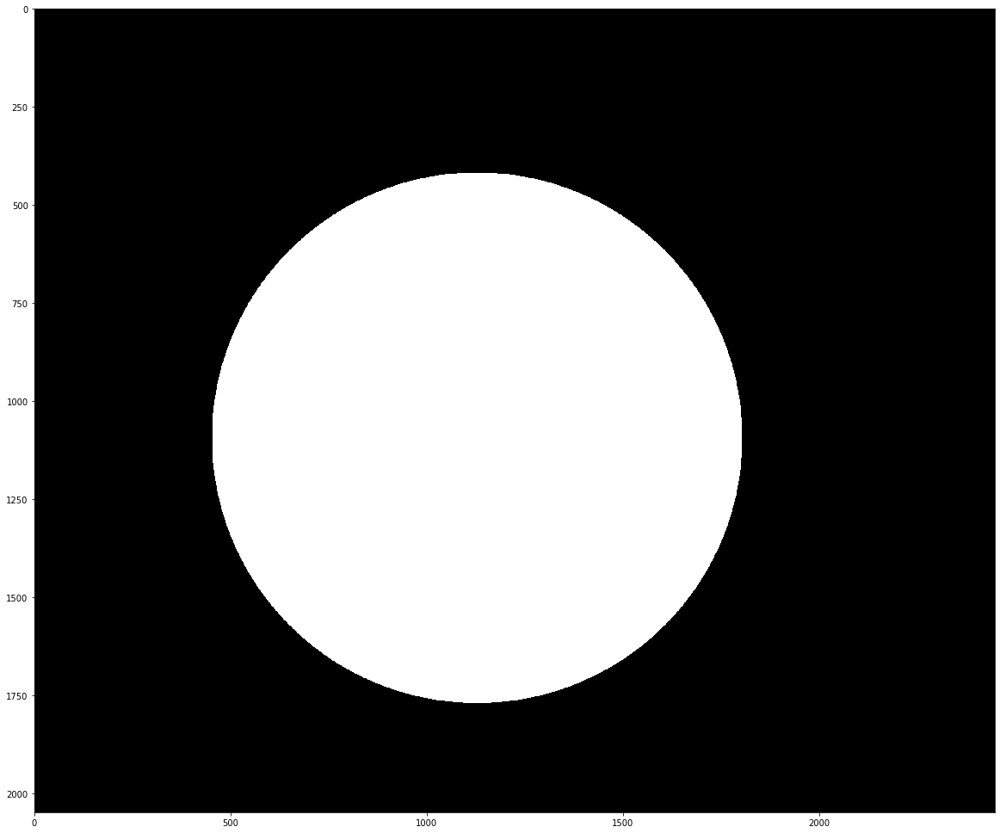

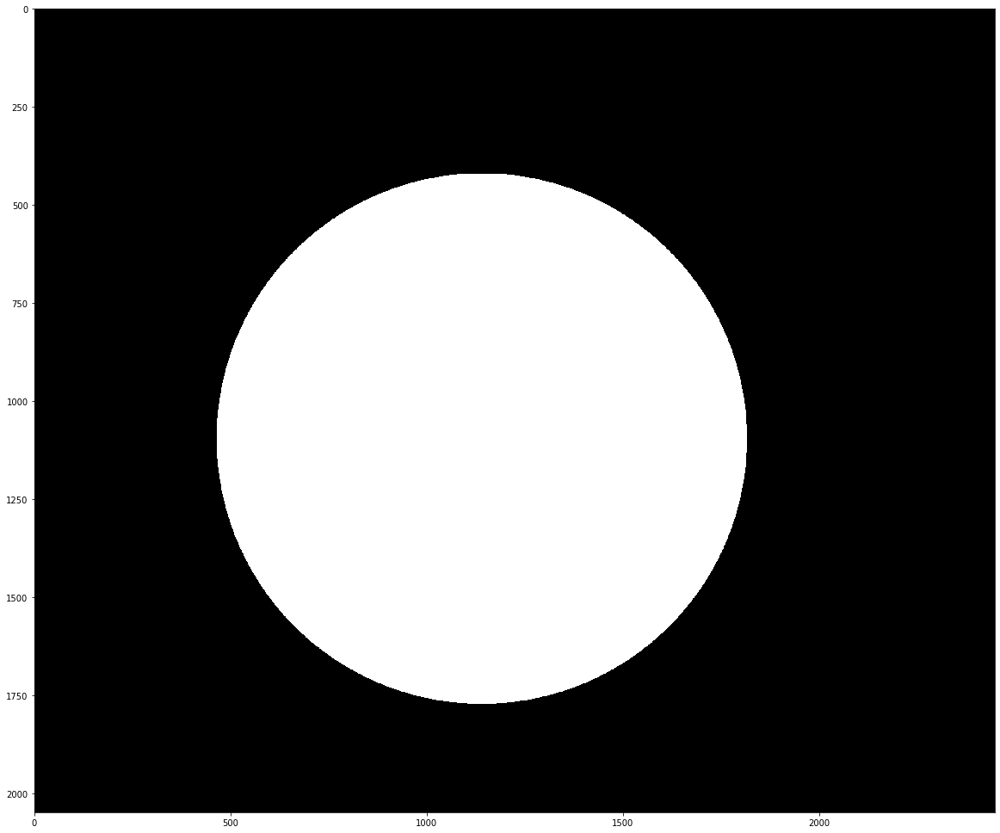

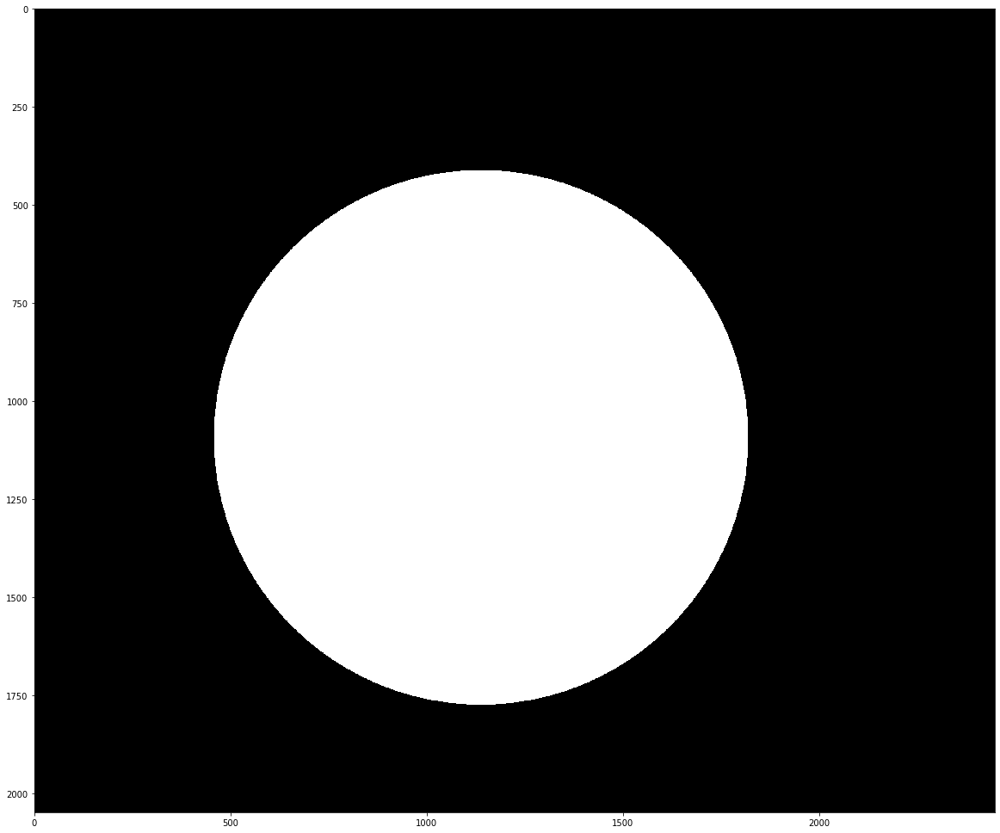

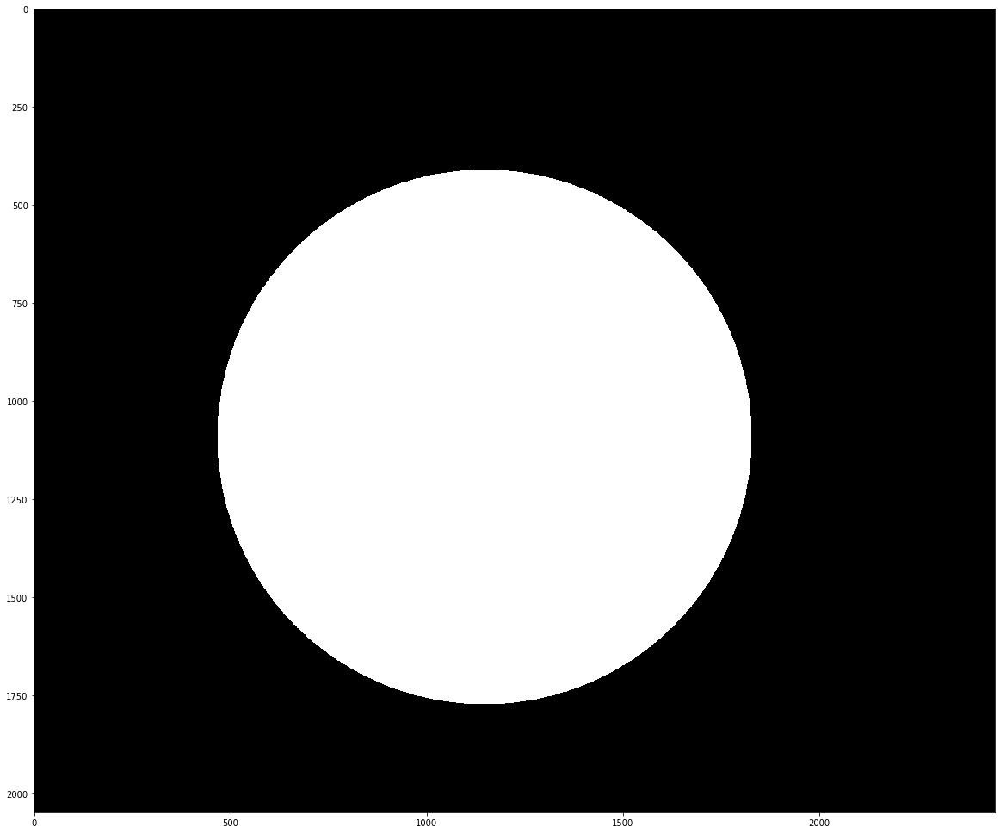

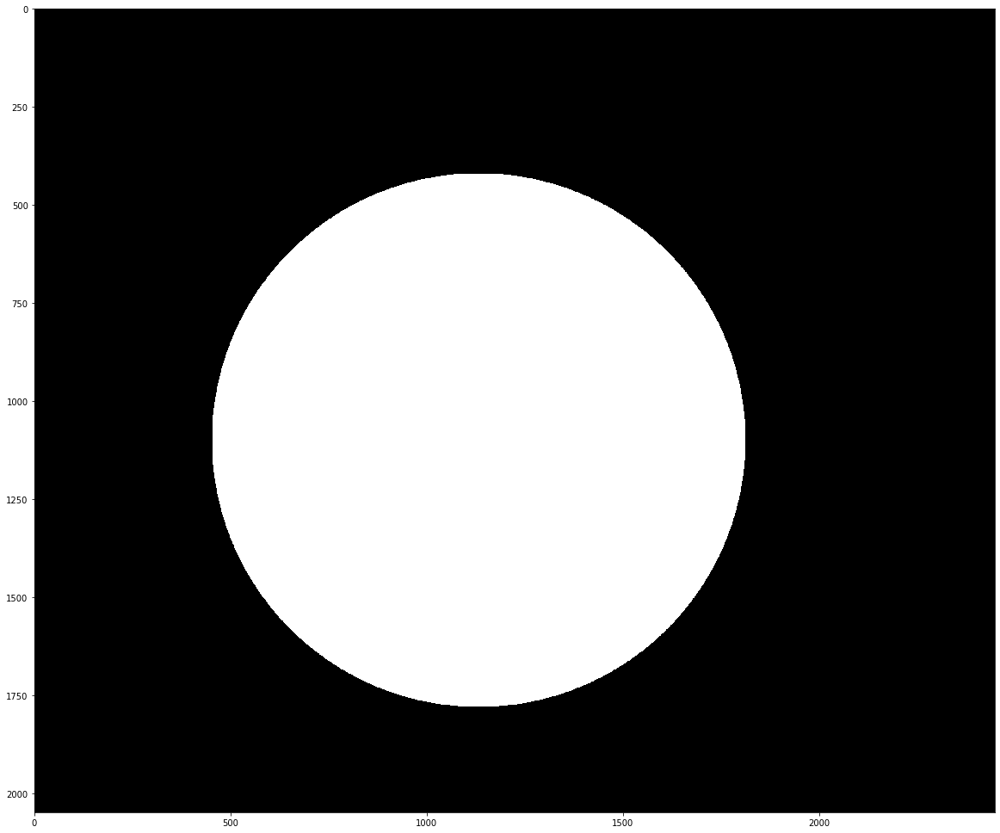

...

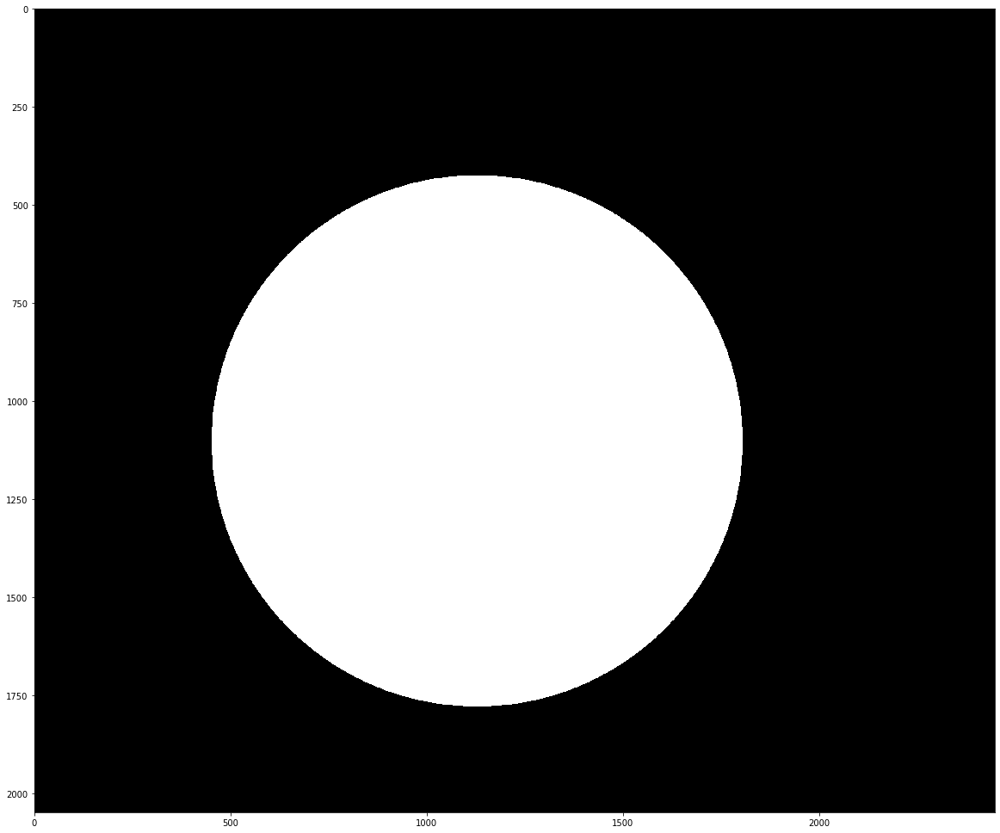

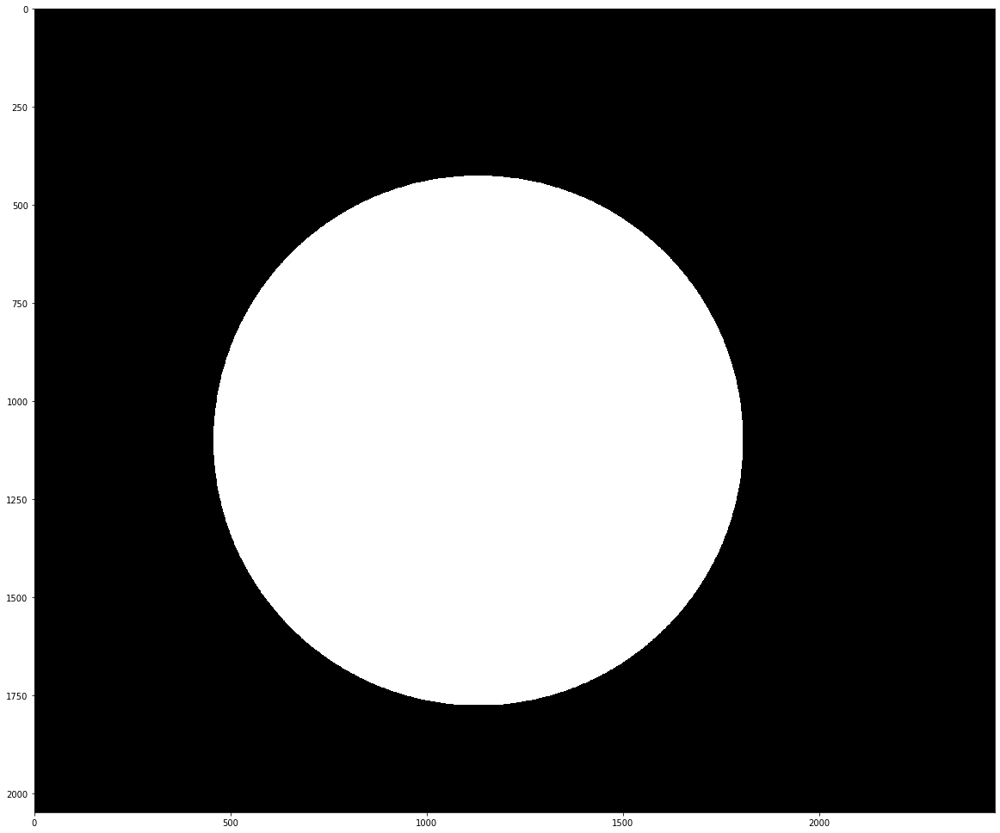

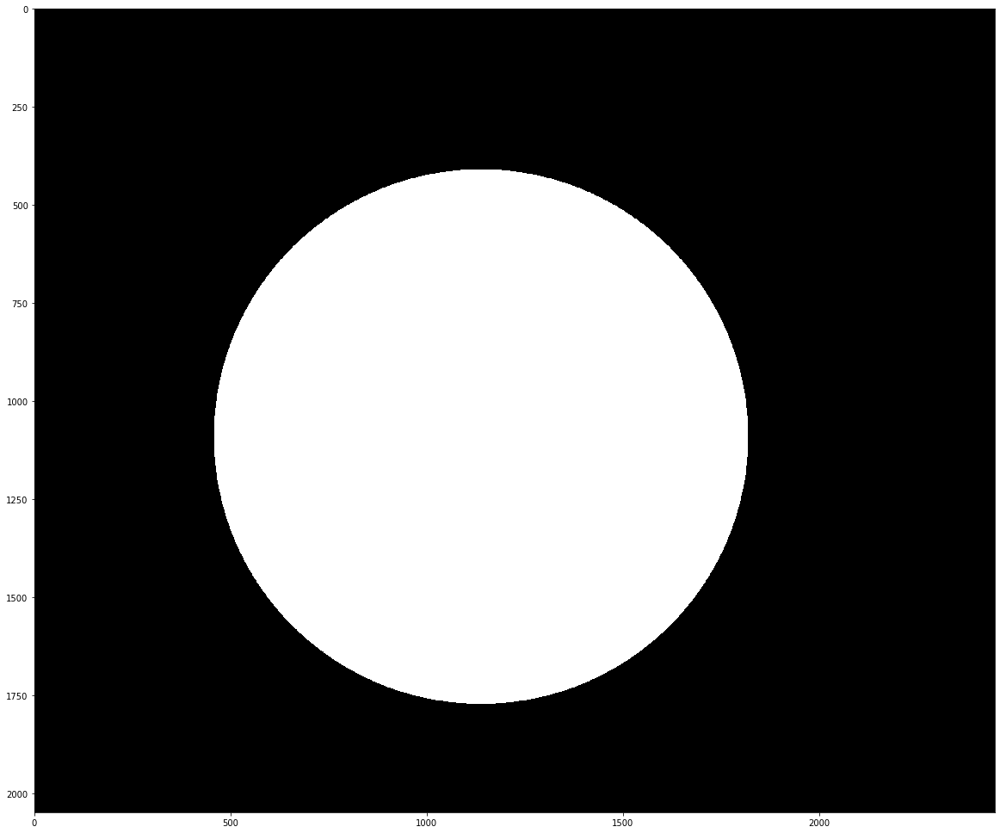

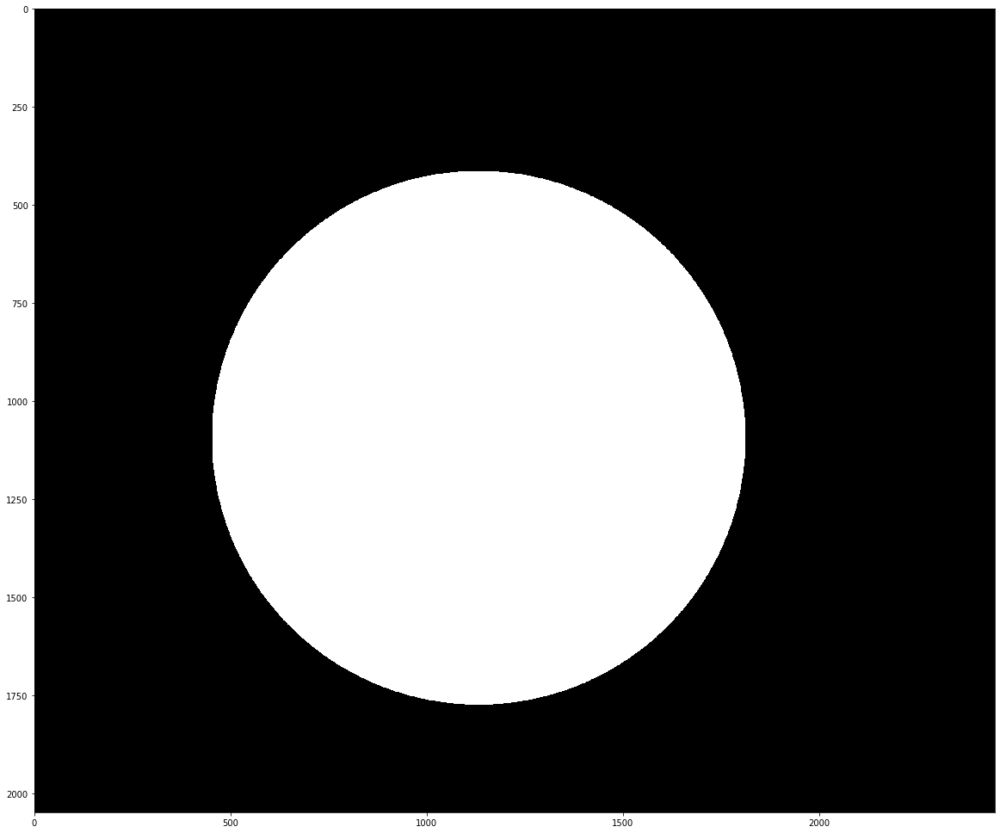

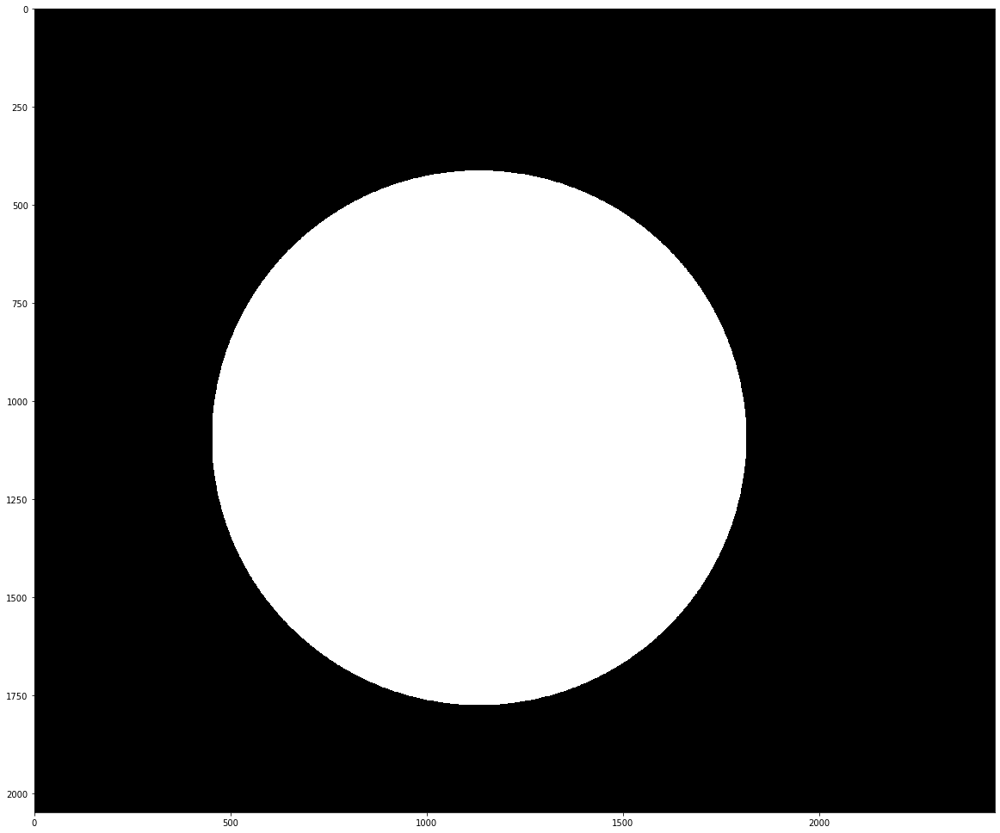

In [17]:
debug = 0
img_list = []
filenamelist= []
for img in glob.glob("0518ALL_Data/CCD-2/*.jpg"):
    #img_list.append(cv2.imread(img,0))
    filenamelist.append(img)

if(debug):
    filenamelist = ["0518ALL_Data/CCD-2/12.jpg"]

for iter_file in range(len(filenamelist)):
    start = time.time()
    filename = filenamelist[iter_file]
    #filename = filenamelist[0]
    print(filename)
    original_image = np.array(cv2.imread(filename,0))
    #image = original_image.copy()
    
    backtorgb = cv2.cvtColor(original_image,cv2.COLOR_GRAY2RGB)   
    mask_inner_cycle_image,contours_final = mask_innercicle(original_image,debug)
    
    #=====Find Defect outer
    stats, mask = FindContour_and_outer_defect(original_image,contours_final,debug)
    #mask outer glass noise
    #print(mask[mask=0])
    original_image = mask_inner_cycle_image
    #image[mask==0] = 255
    #===================Draw outer defect=============================    
    for j in range(len(stats)):
        area = stats[j][4]
        if(area < 20000):
            cv2.rectangle(backtorgb, (stats[j][0], stats[j][1]), 
                          (stats[j][0]+stats[j][2], stats[j][1]+stats[j][3]), (0, 255,0),3)
    #=============================法2: mser============================
    
    area_threshold_1 = 200
    area_threshold_2 = 800
    
    original_image = cv2.cv2.GaussianBlur(original_image,(3,3),0,0)
    #kernel = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
    #original_image = cv2.filter2D(original_image, -1, kernel)
    
    if(debug):
        plt.figure(figsize=(20,20))
        plt.imshow(original_image,cmap = 'gray')
        
    for i in range(1):
        if i==0 :
            mser = cv2.MSER_create(_delta=6, _min_area=200,_max_variation=1)
        '''
        else:
            mser = cv2.MSER_create(_delta=6, _min_area=area_threshold_1, _max_area = area_threshold_2, _max_variation=1.6)
        '''
        regions = mser.detectRegions(original_image)
        
        hulls_draw = [cv2.convexHull(p.reshape(-1, 1, 2)) for p in regions[0]]
        #hulls_draw = [cv2.approxPolyDP(p.reshape(-1, 1, 2), 0.5, True) for p in regions[0]]
        hulls = [cv2.approxPolyDP(p.reshape(-1, 1, 2), 0.5, True) for p in regions[0]]
        #==============每個小區域去看內部的min和mean，因為有的是太白，並非太黑
        
        for j in range(np.array(hulls).shape[0]):
            if(i==0):
                mask = np.zeros_like(original_image)
                mask_now = cv2.fillPoly(mask, [hulls[j]],1)
                mask_1 = original_image*mask_now
                min_in_poly = np.min(mask_1[mask_1>0])
                mean_in_poly =np.mean(mask_1[(mask_1>0)])

                #region around the defect area
                mean_in_poly2 = [255 for n in range(4)]
                M = [np.float32([[1, 0, 15], [0, 1, -15]]),np.float32([[1, 0, 15], [0, 1, 15]]),np.float32([[1, 0, -15], [0, 1, -15]]),np.float32([[1, 0, -15], [0, 1, 15]])]                

                (rows, cols) = mask_now.shape[:2]
                for M_iter in range(len(M)):
                    mask_2 = cv2.warpAffine(mask_now, M[M_iter], (cols, rows)) 
                    mask_2 = original_image*mask_2
                    mean_now = np.mean(mask_2[(mask_2>0)&(mask_2<230)])
                    if(not (math.isnan(mean_now))):
                        mean_in_poly2[M_iter] = mean_now
                
                #print(mean_in_poly, " ", mean_in_poly2)
                flag = sum(mean_in_poly>mean_in_poly2)
                
                # 可以用更好的方法處理邊界問題
                if(flag>1 or mean_in_poly > 130 or min_in_poly>110):
                #if(flag>1):
                    continue
                #print(min_in_poly," ",mean_in_poly, " ", mean_in_poly2)
            cv2.polylines(backtorgb, [hulls_draw[j]], 1, (255,0, 0),3)
            
    
    #=================================================================
    end = time.time()
    print(end - start)
    print(".\\Detect\\Stop2" +filenamelist[iter_file][18:-4]+'_Detect.jpg')
    cv2.imwrite(".\\Detect\\Stop2" +filenamelist[iter_file][18:-4]+'_Detect.jpg',backtorgb)
    
    if(debug):
        plt.figure(figsize=(20,20))
        plt.imshow(backtorgb)
#   plt.close()

In [283]:
'''
#parameter before:
1.
image = cv2.GaussianBlur(image,(15,15),0,0)
image = cv2.Canny(image,20,47,3)

=>problem: 45.jpg 26.jpg 43.jpg


'''

'\n#parameter before:\n1.\nimage = cv2.GaussianBlur(image,(15,15),0,0)\nimage = cv2.Canny(image,20,47,3)\n\n=>problem: 45.jpg 26.jpg\n\n\n'

## Try

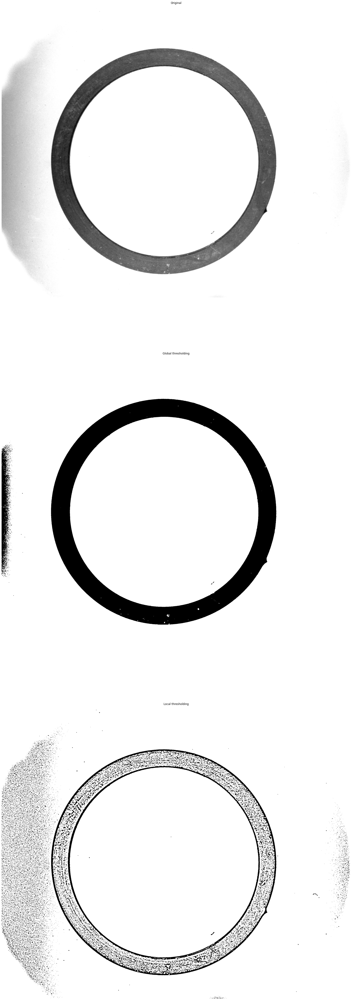

In [60]:
from skimage.filters import threshold_otsu, threshold_local


image = original_image
image = cv2.GaussianBlur(image,(3,3),0,0)

global_thresh = threshold_otsu(image)
binary_global = image > global_thresh

block_size = 35
local_thresh = threshold_local(image, block_size, offset=3)
binary_local = image > local_thresh

fig, axes = plt.subplots(nrows=3, figsize=(70, 80))
ax = axes.ravel()
plt.gray()

ax[0].imshow(image)
ax[0].set_title('Original')

ax[1].imshow(binary_global)
ax[1].set_title('Global thresholding')

ax[2].imshow(binary_local)
ax[2].set_title('Local thresholding')

for a in ax:
    a.axis('off')

plt.show()

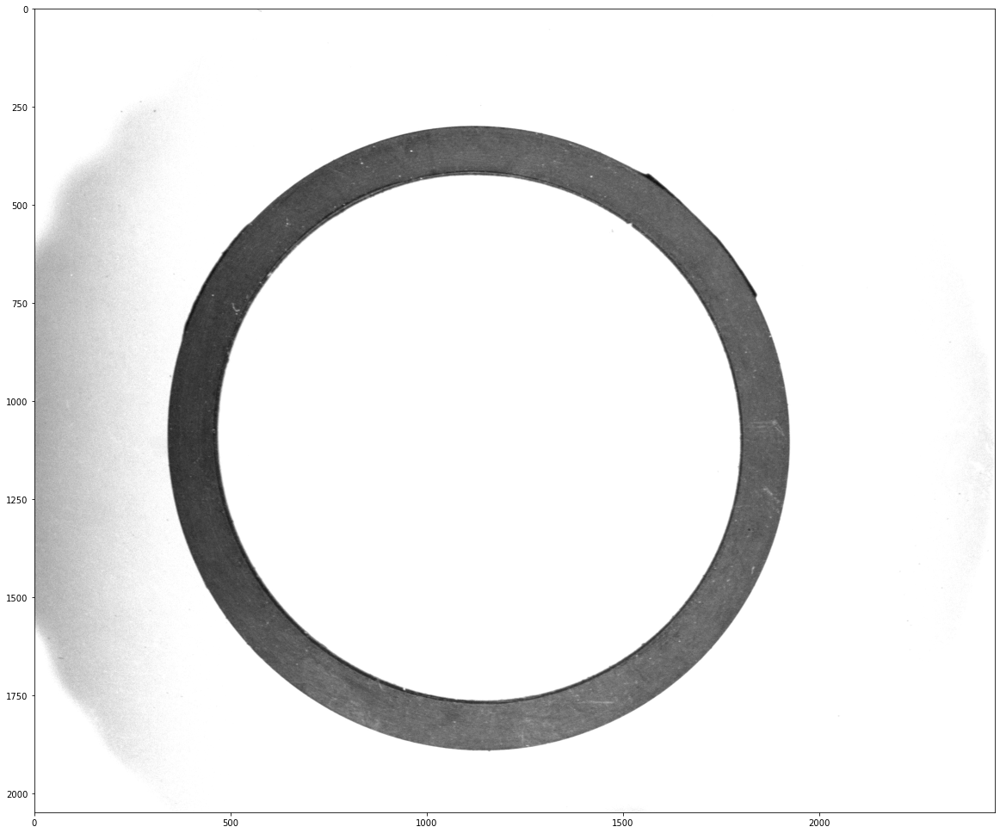

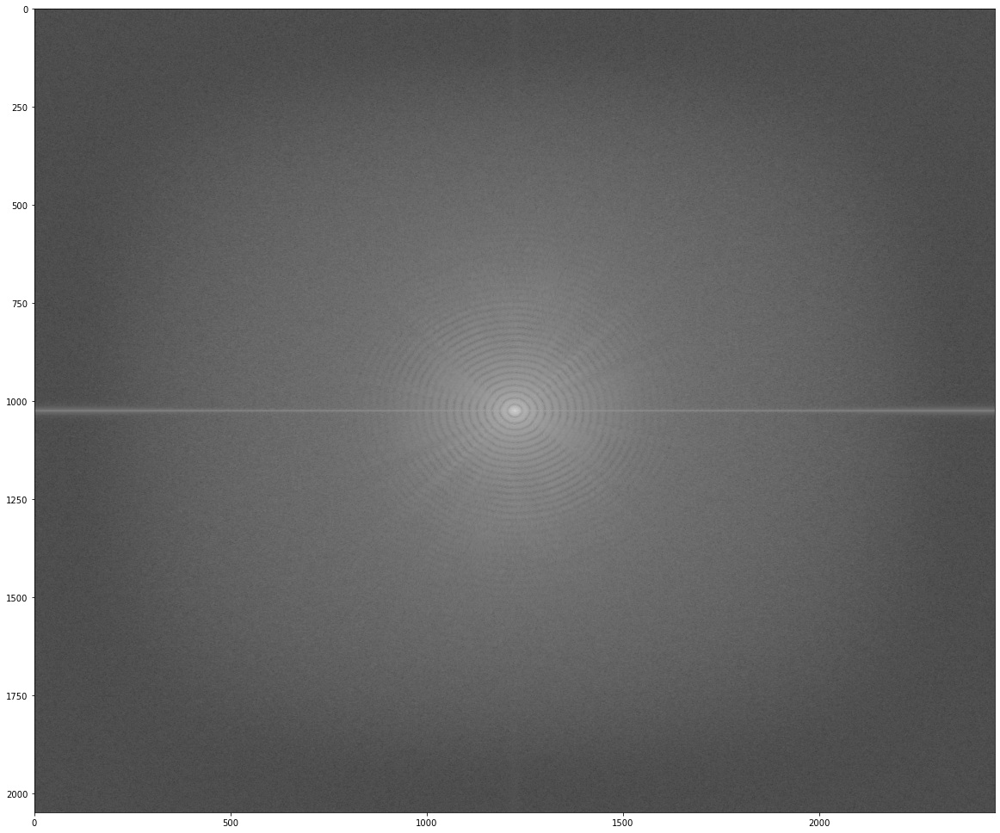

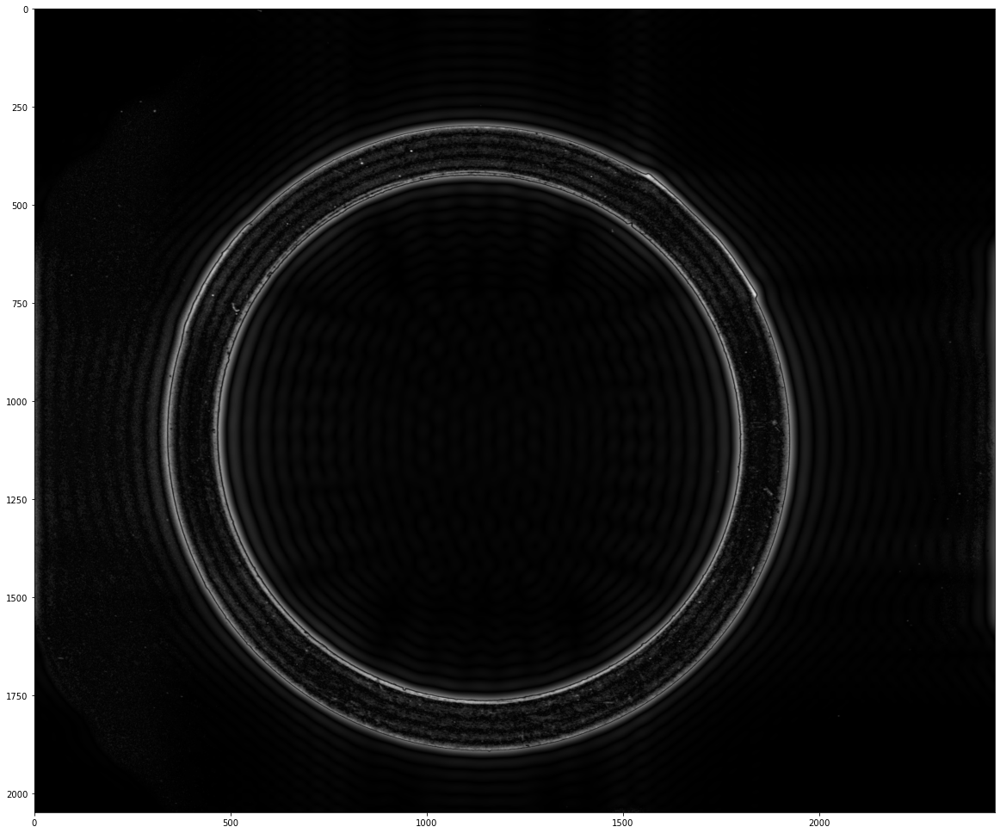

In [72]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

original_image = np.array(cv2.imread("0518ALL_Data/CCD-2/108.jpg",0))
plt.figure(figsize=(20,20))
plt.imshow(original_image,cmap = 'gray')

img = original_image
img = cv2.GaussianBlur(img,(3,3),0,0)
f = np.fft.fft2(img)
fshift = np.fft.fftshift(f)
magnitude_spectrum = 20*np.log(np.abs(fshift))
plt.figure(figsize=(20,20))
plt.imshow(magnitude_spectrum)


rows, cols = img.shape
crow,ccol = rows//2 , cols//2
fshift[crow-30:crow+30, ccol-30:ccol+30] = 0
f_ishift = np.fft.ifftshift(fshift)
img_back = np.fft.ifft2(f_ishift)
img_back = np.abs(img_back)
plt.figure(figsize=(20,20))
plt.imshow(img_back)